In [1]:
import nibabel as nib
from utils import create_video
from PIL import Image
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os
import scipy.io


In [4]:
%cd "DBS_bT20"

C:\Users\VukadinoviM\Documents\BrainReg\DBS_bT20


## Preop CT scan

In [78]:
nim = nib.load("rpreop_ct.nii")
image = np.nan_to_num(nim.get_fdata())

In [79]:
gg = np.array((image-np.min(image))/(np.max(image)-np.min(image))*255).astype('int')

In [83]:
from utils import video_to_points
ct_hull = video_to_points(np.array(gg > 150).astype('int'))

In [95]:
xzero
yzero
zzero

97.24272253760168

In [99]:
image.shape

(256, 256, 192)

In [102]:
128

128

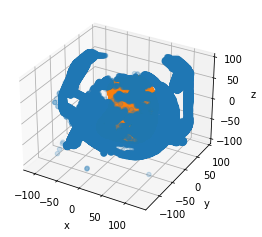

In [92]:
xzero = np.mean(ct_hull[:,0])
yzero = np.mean(ct_hull[:,1])
zzero = np.mean(ct_hull[:,2])
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter3D(ct_hull[:,0]-xzero, ct_hull[:,1]-yzero, ct_hull[:,2]-zzero, cmap='green', alpha=0.2)
ax.scatter3D(points_hull[:,2], points_hull[:,0], points_hull[:,1], cmap='green', alpha=0.2)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z');

In [29]:
create_video(image, dim=0)

In [8]:
create_video(image, dim=1)

In [14]:
create_video(image, dim=2)

## Postop CT scan

In [9]:
nim = nib.load("rpostop_ct.nii")
image = nim.get_fdata()

In [11]:
create_video(image, dim=0)

KeyboardInterrupt: 

In [ ]:
create_video(image, dim=1)

In [ ]:
create_video(image, dim=2)

## MRI T1

In [8]:
nim = nib.load("T1.nii")
image = nim.get_fdata()

In [9]:
create_video(image)

memmap([[[[0.],
          [0.],
          [0.],
          ...,
          [0.],
          [0.],
          [0.]],

         [[0.],
          [0.],
          [0.],
          ...,
          [0.],
          [0.],
          [0.]],

         [[0.],
          [0.],
          [0.],
          ...,
          [0.],
          [0.],
          [0.]],

         ...,

         [[0.],
          [0.],
          [0.],
          ...,
          [0.],
          [0.],
          [0.]],

         [[0.],
          [0.],
          [0.],
          ...,
          [0.],
          [0.],
          [0.]],

         [[0.],
          [0.],
          [0.],
          ...,
          [0.],
          [0.],
          [0.]]],


        [[[0.],
          [0.],
          [0.],
          ...,
          [0.],
          [0.],
          [0.]],

         [[0.],
          [0.],
          [0.],
          ...,
          [0.],
          [0.],
          [0.]],

         [[0.],
          [0.],
          [0.],
          ...,
          [0.],


## Fluoroscopy Image

In [15]:
import imageio
im = imageio.imread('fluoro01.tif')

C:\Users\VukadinoviM\AppData\Local\Temp\ipykernel_32004\168931411.py:2: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  im = imageio.imread('fluoro01.tif')


In [22]:
im.shape

(1222, 1527, 4)

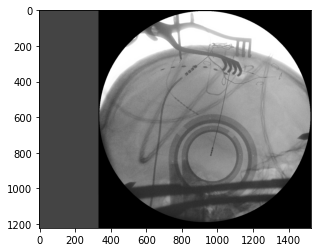

In [20]:
plt.imshow(im)

In [3]:
import scipy.io
mat = scipy.io.loadmat("Electrode_Locations_JWC/electrode_locs.mat")

In [4]:
mat

{'__header__': b'MATLAB 5.0 MAT-file, Platform: PCWIN64, Created on: Fri Aug 28 22:35:58 2020',
 '__version__': '1.0',
 '__globals__': [],
 'CortElecLoc': array([[array([[ 48.88512421, -73.83932495,  21.71887207]]),
         array([[ 45.88512421, -68.83932495,  28.71887207]]),
         array([[ 44.88512421, -62.83932495,  34.71887207]]),
         array([[ 44.88512421, -55.83932495,  40.71887207]]),
         array([[ 45.88512421, -47.83932495,  44.71887207]]),
         array([[ 42.88512421, -39.83932495,  47.71887207]]),
         array([[ 39.88512421, -31.83932495,  50.71887207]]),
         array([[ 43.88512421, -21.83932495,  51.71887207]])]],
       dtype=object)}

# MRI HULL

In [15]:

hull = scipy.io.loadmat("hull_rh.mat")

In [16]:
points_hull = hull['mask_indices']

In [18]:
pins_ct = np.array([[ 48.88512421, -73.83932495,  21.71887207],
                   [ 45.88512421, -68.83932495,  28.71887207],
                   [ 44.88512421, -62.83932495,  34.71887207],
                   [ 44.88512421, -55.83932495,  40.71887207],
                   [ 45.88512421, -47.83932495,  44.71887207],
                   [ 42.88512421, -39.83932495,  47.71887207],
                   [ 39.88512421, -31.83932495,  50.71887207],
                   [ 43.88512421, -21.83932495,  51.71887207]])

In [23]:
points_hull

array([[ 17.88512421, -97.83932495,  -8.28112793],
       [ 16.88512421, -97.83932495,  -8.28112793],
       [ 18.88512421, -97.83932495,  -9.28112793],
       ...,
       [ 11.88512421,  59.16067505,  16.71887207],
       [ 10.88512421,  59.16067505,  16.71887207],
       [  9.88512421,  59.16067505,  16.71887207]])

In [6]:
nim = nib.load("rpreop_ct.nii")
image = np.nan_to_num(nim.get_fdata())

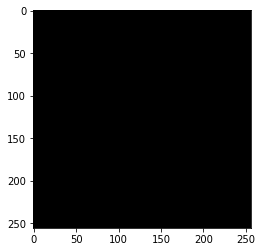

In [12]:
plt.imshow(np.array(image[:,:,100]==254),cmap='gray')

In [13]:
np.unique(image[:,:,100])

array([-1051.84277344, -1044.01953125, -1043.09399414, ...,
        2094.07446289,  2110.78198242,  2116.67480469])

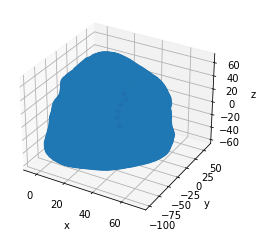

In [85]:
import matplotlib.pyplot as plt

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter3D(points_hull[:,0], points_hull[:,1], points_hull[:,2], cmap='green', alpha=0.2)
ax.scatter3D(pins_ct[:,0], pins_ct[:,1], pins_ct[:,2], c='r',)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z');

array([[ 17.88512421, -97.83932495,  -8.28112793],
       [ 16.88512421, -97.83932495,  -8.28112793],
       [ 18.88512421, -97.83932495,  -9.28112793],
       ...,
       [ 11.88512421,  59.16067505,  16.71887207],
       [ 10.88512421,  59.16067505,  16.71887207],
       [  9.88512421,  59.16067505,  16.71887207]])

In [16]:
import plotly
import plotly.graph_objs as go
plotly.offline.init_notebook_mode()
# Configure the layout.
layout = go.Layout(
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)
plot_figure = go.Figure(data=[go.Mesh3d(x=points_hull[:,0],
                                           y=points_hull[:,2],
                                           z=-points_hull[:,1], 
                                           color="pink", 
                                           opacity=.5,
                                           alphahull=0),
                             go.Scatter3d(x=pins_ct[:,0],
                                           y=pins_ct[:,1],
                                           z=pins_ct[:,2], 
                                           mode='markers')])
# Render the plot.
plotly.offline.iplot(plot_figure)

In [17]:
pins_ct

array([[ 48.88512421, -73.83932495,  21.71887207],
       [ 45.88512421, -68.83932495,  28.71887207],
       [ 44.88512421, -62.83932495,  34.71887207],
       [ 44.88512421, -55.83932495,  40.71887207],
       [ 45.88512421, -47.83932495,  44.71887207],
       [ 42.88512421, -39.83932495,  47.71887207],
       [ 39.88512421, -31.83932495,  50.71887207],
       [ 43.88512421, -21.83932495,  51.71887207]])

In [18]:
points_hull

array([[ 17.88512421, -97.83932495,  -8.28112793],
       [ 16.88512421, -97.83932495,  -8.28112793],
       [ 18.88512421, -97.83932495,  -9.28112793],
       ...,
       [ 11.88512421,  59.16067505,  16.71887207],
       [ 10.88512421,  59.16067505,  16.71887207],
       [  9.88512421,  59.16067505,  16.71887207]])